<div class="usecase-title">Nearby Restaurant Hotspots Analysis in Melbourne</div>
<div class="usecase-authors"><b>Authored by: </b> Tharaka Sandamal And Sahan Chamod</div>

<div class="usecase-duration"><b>Duration:</b> 90 mins</div>
<div class="usecase-level-skill">
    <div class="usecase-level"><b>Level: </b>Intermediate</div>
    <div class="usecase-skill"><b>Pre-requisite Skills: </b>Python, Data Analysis, Pandas, Data Visualization</div>


<div class="usecase-section-header">Scenario</div>

As office workers in Melbourne, finding a convenient and available place to eat during lunch can be a challenge due to limited seating capacity and high business activity. The goal is to identify areas in Melbourne that need more restaurants, cafes, or bistros based on the current seating capacity and nearby business activity. This analysis will help urban planners and business owners make informed decisions about where to establish new eateries to meet the demand.

At the end of this use case you will:
- Learn how to clean and merge multiple datasets using Pandas.
- Perform exploratory data analysis to understand the relationship between seating capacity and business activity.
- Use data visualization techniques to identify potential hotspots for new restaurants.
- Generate actionable insights to inform decision-making in urban planning and business development.

Melbourne is a bustling city with a significant number of office workers who frequently visit nearby cafes and restaurants for lunch. However, the availability of seating and the proximity of eateries to business hubs can affect their choices. This analysis aims to determine which areas in Melbourne need more dining options by analyzing datasets related to seating capacity, business activity, and land use. By combining these datasets, we can identify regions with high demand but insufficient seating capacity, guiding new restaurant openings to better serve the community.

<h1> <div class="usecase-section-header">Project Stages</div>


1. **Data Collection**:
   Download the necessary datasets.
   - [Cafes and Restaurants with Seating Capacity](https://data.melbourne.vic.gov.au/explore/dataset/cafes-and-restaurants-with-seating-capacity/information/)
   - [Employment by Block by CLUE Industry](https://data.melbourne.vic.gov.au/explore/dataset/employment-by-block-by-clue-industry/information/)
   - [Blocks for Census of Land Use and Employment (CLUE)](https://data.melbourne.vic.gov.au/explore/dataset/blocks-for-census-of-land-use-and-employment-clue/information/?sort=-block_id&location=13,-37.81306,144.94413&basemap=mbs-7a7333)

2. **Data Cleaning and Preparation**:
   - Load the datasets into Pandas DataFrames.
   - Inspect and clean the data.
   - Merge the datasets on common fields.

3. **Data Analysis**:
   - Calculate the total seating capacity of cafes and restaurants per block.
   - Analyze the employment data to understand the density of workers per block.

4. **Determine Hotspots**:
   - Identify blocks with high business activity but low seating capacity.
   - Highlight areas with a mismatch between the number of employees and available seating.

5. **Visualization**:
   - Create visualizations to show areas with high demand for more restaurants/cafes.
   - Present findings in a clear and impactful manner.

<div class="usecase-section-header">Expected Outcome</div>
The expected outcome of this project is to identify specific areas in Melbourne that require additional restaurants, cafes, or bistros based on the analysis of seating capacity, business activity, and possibly pedestrian movement data. This will provide urban planners and business owners with actionable insights to make informed decisions about where to establish new dining options to meet the demand of office workers.




<div class="usecase-section-header">Dataset Descriptions</div>

1. **Cafes and Restaurants with Seating Capacity**:
   - This dataset contains information about cafes and restaurants in Melbourne, including their seating capacity.
   - [Link to Dataset](https://data.melbourne.vic.gov.au/explore/dataset/cafes-and-restaurants-with-seating-capacity/information/)

2. **Employment by Block by CLUE Industry**:
   - This dataset provides employment information by block and industry within Melbourne, indicating the density of business activity.
   - [Link to Dataset](https://data.melbourne.vic.gov.au/explore/dataset/employment-by-block-by-clue-industry/information/)

3. **Blocks for Census of Land Use and Employment (CLUE)**:
   - This dataset includes detailed information about blocks in Melbourne, used for the Census of Land Use and Employment.
   - [Link to Dataset](https://data.melbourne.vic.gov.au/explore/dataset/blocks-for-census-of-land-use-and-employment-clue/information/?sort=-block_id&location=13,-37.81306,144.94413&basemap=mbs-7a7333)

# Package/Library Imports

In [5]:
from config import API_KEY # import API_KEY from config file

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import requests 
import pandas as pd 
from io import StringIO
import squarify

# Read data using API

In [6]:
# **Preferred Method**: Export Endpoint

#Function to collect data 
def collect_data(dataset_id):
    base_url = 'https://data.melbourne.vic.gov.au/api/explore/v2.1/catalog/datasets/'
    dataset_id = dataset_id
    format = 'csv'

    url = f'{base_url}{dataset_id}/exports/{format}'
    params = {
    'select': '*',
    'limit': -1, # all records
    'lang': 'en',
    'timezone': 'UTC',
    'api_key': API_KEY #use if use datasets require API key permissions
    }

    # GET request
    response = requests.get(url, params=params)
    if response.status_code == 200:
        # StringIO to read the CSV data
        url_content = response.content.decode('utf-8')
        dataset = pd.read_csv(StringIO(url_content), delimiter=';')
        return dataset 
    else:
        print(f'Request failed with status code {response.status_code}')

# Read data using the function
cafe_df = collect_data('cafes-and-restaurants-with-seating-capacity')
emp_block_df = collect_data('employment-by-block-by-clue-industry')
block_df = collect_data('blocks-for-census-of-land-use-and-employment-clue')
Small_CLUE_area = collect_data('small-areas-for-census-of-land-use-and-employment-clue')

# Learn and explore the data

## Cafes/Restaurants with seating capacity

In [7]:
print(f'Shape of the cafe_df:\t{cafe_df.shape}')
cafe_df.head(5)

Shape of the cafe_df:	(60055, 15)


,census_year,block_id,property_id,base_property_id,building_address,clue_small_area,trading_name,business_address,industry_anzsic4_code,industry_anzsic4_description,seating_type,number_of_seats,longitude,latitude,location
0,2017,6,578324,573333,2 Swanston Street MELBOURNE 3000,Melbourne (CBD),Transport Hotel,"Tenancy 29, Ground , 2 Swanston Street MELBOUR...",4520,"Pubs, Taverns and Bars",Seats - Indoor,230,144.969942,-37.817778,"-37.817777826050005, 144.96994164279243"
1,2017,6,578324,573333,2 Swanston Street MELBOURNE 3000,Melbourne (CBD),Transport Hotel,"Tenancy 29, Ground , 2 Swanston Street MELBOUR...",4520,"Pubs, Taverns and Bars",Seats - Outdoor,120,144.969942,-37.817778,"-37.817777826050005, 144.96994164279243"
2,2017,11,103957,103957,517-537 Flinders Lane MELBOURNE 3000,Melbourne (CBD),Altius Coffee Brewers,"Shop , Ground , 517 Flinders Lane MELBOURNE 3000",4512,Takeaway Food Services,Seats - Outdoor,4,144.956486,-37.819875,"-37.819875445799994, 144.95648638781466"
3,2017,11,103957,103957,517-537 Flinders Lane MELBOURNE 3000,Melbourne (CBD),Five & Dime Bagel,16 Flinders Lane MELBOURNE 3000,1174,Bakery Product Manufacturing (Non-factory based),Seats - Indoor,14,144.956486,-37.819875,"-37.819875445799994, 144.95648638781466"
4,2017,11,103985,103985,562-564 Flinders Street MELBOURNE 3000,Melbourne (CBD),YHA Melbourne Central,562-564 Flinders Street MELBOURNE 3000,4400,Accommodation,Seats - Indoor,43,144.955635,-37.820595,"-37.82059511593975, 144.9556348088"


In [8]:
print('-'*20,'cafe_df Info','-'*20)
print()
# display all columns, non-null count and their data types
print(cafe_df.info())

-------------------- cafe_df Info --------------------

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 60055 entries, 0 to 60054
Data columns (total 15 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   census_year                   60055 non-null  int64  
 1   block_id                      60055 non-null  int64  
 2   property_id                   60055 non-null  int64  
 3   base_property_id              60055 non-null  int64  
 4   building_address              60055 non-null  object 
 5   clue_small_area               60055 non-null  object 
 6   trading_name                  60055 non-null  object 
 7   business_address              60055 non-null  object 
 8   industry_anzsic4_code         60055 non-null  int64  
 9   industry_anzsic4_description  60055 non-null  object 
 10  seating_type                  60055 non-null  object 
 11  number_of_seats               60055 non-null  int64  
 12  long

According to the above output there are number of null values in the cafe_df need to be addressed.

## Employment by block

In [9]:
print(f'Shape of the emp_block_df:\t{emp_block_df.shape}')
emp_block_df.head(5)

Shape of the emp_block_df:	(12394, 24)


,census_year,block_id,clue_small_area,accommodation,admin_and_support_services,agriculture_and_mining,arts_and_recreation_services,business_services,construction,education_and_training,...,information_media_and_telecommunications,manufacturing,other_services,public_administration_and_safety,real_estate_services,rental_and_hiring_services,retail_trade,transport_postal_and_storage,wholesale_trade,total_jobs_in_block
0,2022,4,Melbourne (CBD),0.0,0.0,0.0,362.0,0.0,0.0,NaN,...,0.0,0.0,NaN,0.0,0.0,0.0,38.0,368.0,0.0,1008.0
1,2022,5,Melbourne (CBD),0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2022,6,Melbourne (CBD),0.0,0.0,0.0,203.0,0.0,0.0,0.0,...,NaN,0.0,NaN,0.0,NaN,0.0,47.0,0.0,0.0,647.0
3,2022,13,Melbourne (CBD),NaN,520.0,0.0,NaN,496.0,NaN,NaN,...,55.0,NaN,27.0,0.0,0.0,0.0,NaN,NaN,0.0,2379.0
4,2022,16,Melbourne (CBD),NaN,NaN,0.0,86.0,382.0,295.0,NaN,...,0.0,0.0,64.0,0.0,NaN,0.0,60.0,0.0,0.0,2404.0


In [10]:
print('-'*20,'emp_block_df Info','-'*20)
print()
# display all columns, non-null count and their data types
print(emp_block_df.info())

-------------------- emp_block_df Info --------------------

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12394 entries, 0 to 12393
Data columns (total 24 columns):
 #   Column                                    Non-Null Count  Dtype  
---  ------                                    --------------  -----  
 0   census_year                               12394 non-null  int64  
 1   block_id                                  12394 non-null  int64  
 2   clue_small_area                           12394 non-null  object 
 3   accommodation                             9986 non-null   float64
 4   admin_and_support_services                10375 non-null  float64
 5   agriculture_and_mining                    11795 non-null  float64
 6   arts_and_recreation_services              8467 non-null   float64
 7   business_services                         10519 non-null  float64
 8   construction                              10319 non-null  float64
 9   education_and_training                    98

According to the above output there are number of null values in the emp_block_df need to be addressed.

## Blocks info

In [11]:
print(f'Shape of the block_df:\t{block_df.shape}')
block_df.head(5)

Shape of the block_df:	(606, 4)


,geo_point_2d,geo_shape,block_id,clue_area
0,"-37.82296169692379, 144.95049282288122","{""coordinates"": [[[144.9479230372, -37.8233694...",1112,Docklands
1,"-37.78537422996195, 144.94085920366408","{""coordinates"": [[[144.9426153438, -37.7866287...",927,Parkville
2,"-37.777687358375964, 144.94600024715058","{""coordinates"": [[[144.9425926939, -37.7787229...",929,Parkville
3,"-37.796701447217345, 144.94361235073427","{""coordinates"": [[[144.9447165759, -37.7961286...",318,North Melbourne
4,"-37.79293972627454, 144.94371829763847","{""coordinates"": [[[144.9453910459, -37.7925266...",302,North Melbourne


In [12]:
block_df['block_id'] = block_df['block_id'].astype(str)

In [13]:
print('-'*20,'block_df Info','-'*20)
print()
# display all columns, non-null count and their data types
print(block_df.info())

-------------------- block_df Info --------------------

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 606 entries, 0 to 605
Data columns (total 4 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   geo_point_2d  606 non-null    object
 1   geo_shape     606 non-null    object
 2   block_id      606 non-null    object
 3   clue_area     606 non-null    object
dtypes: object(4)
memory usage: 19.1+ KB
None


According to the above output there is no missing values in the block_df.

# Data Preprocessing

## Cafes/Restaurants with seating capacity

**Identify Missing Values**

In [14]:
print('-'*20,'cafe_df missing values','-'*20)
print()
missing_values = cafe_df.isnull().sum()
print(missing_values[missing_values > 0])

-------------------- cafe_df missing values --------------------

longitude    527
latitude     527
location     527
dtype: int64


Based on the above output, the cafe_df contains missing values in the longitude, latitude, and location columns. It is not appropriate to impute these missing values using simple aggregate functions such as mean or median, as these columns represent critical geographical data. 

Additionally, we cannot drop these records at this stage because we are working with three datasets, and these records may still be valuable when we merge them together later. 

**Identify Duplicated Values**

In [15]:
# First, check for duplicates in the dataset
duplicates_count = cafe_df.duplicated().sum()

# Remove duplicates if any
cafes_df_cleaned = cafe_df.drop_duplicates()

# Check again for the number of duplicates after removing them
duplicates_after = cafes_df_cleaned.duplicated().sum()

# Display the result
print(f'Before cleaning, Number of duplicates\t:{duplicates_count}')
print(f'After cleaning, Number of duplicates\t:{duplicates_after}')

Before cleaning, Number of duplicates	:0
After cleaning, Number of duplicates	:0


**Handling Missing Values**

In [16]:
from geopy.geocoders import Nominatim
from geopy.exc import GeocoderTimedOut, GeocoderServiceError
import time

# Initialize the geocoder
geolocator = Nominatim(user_agent="cafe_geocoder")

# Function to get latitude and longitude based on address with retry logic
def get_lat_long(address, retries=3):
    for attempt in range(retries):
        try:
            location = geolocator.geocode(address, timeout=10)
            if location:
                return location.latitude, location.longitude
            else:
                return None, None
        except (GeocoderTimedOut, GeocoderServiceError):
            time.sleep(1)  # Wait before retrying
        except Exception as e:
            return None, None
    return None, None

# Identify rows with missing latitude and longitude using lowercase column names
missing_lat_long = cafes_df_cleaned[cafes_df_cleaned['latitude'].isnull() & cafes_df_cleaned['longitude'].isnull()]

# Geocode the missing values
for idx, row in missing_lat_long.iterrows():
    lat, long = get_lat_long(row['building_address'])
    if lat is not None and long is not None:
        cafes_df_cleaned.at[idx, 'latitude'] = lat
        cafes_df_cleaned.at[idx, 'longitude'] = long

# Check how many missing values are left after the geocoding process
remaining_missing = cafes_df_cleaned[['latitude', 'longitude']].isnull().sum()

print("Remaining missing values after geocoding:")
print(remaining_missing)


Remaining missing values after geocoding:
latitude     96
longitude    96
dtype: int64


In [17]:
# Dropping rows with missing latitude and longitude values
cafes_df_cleaned = cafes_df_cleaned.dropna(subset=['latitude', 'longitude'])

# Verify that all missing values for latitude and longitude have been removed
remaining_missing_after_drop = cafes_df_cleaned[['latitude', 'longitude']].isnull().sum()

# Display the result to confirm no more missing values
remaining_missing_after_drop


latitude     0
longitude    0
dtype: int64

## Employment by block

**Missing Values**

In [18]:
print('-'*20,'emp_block_df missing values','-'*20)
print()
missing_values = emp_block_df.isnull().sum()
print(missing_values[missing_values > 0])

-------------------- emp_block_df missing values --------------------

accommodation                               2408
admin_and_support_services                  2019
agriculture_and_mining                       599
arts_and_recreation_services                3927
business_services                           1875
construction                                2075
education_and_training                      2553
electricity_gas_water_and_waste_services    2468
finance_and_insurance                       1578
food_and_beverage_services                  2628
health_care_and_social_assistance           2560
information_media_and_telecommunications    2298
manufacturing                               2309
other_services                              3280
public_administration_and_safety            1852
real_estate_services                        1791
rental_and_hiring_services                   860
retail_trade                                2510
transport_postal_and_storage                224

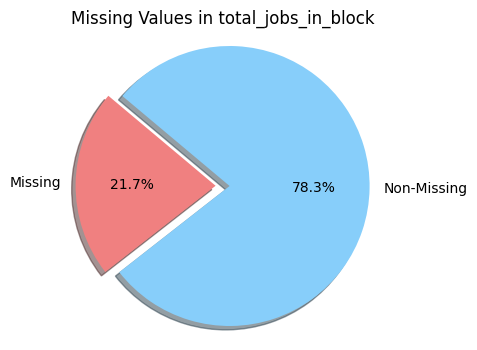

In [19]:
# Step 1: Count missing and non-missing values
missing_total_jobs_count = emp_block_df['total_jobs_in_block'].isnull().sum()
non_missing_total_jobs_count = emp_block_df['total_jobs_in_block'].notnull().sum()

# Create a dictionary for the counts
missing_data = {
    'Missing': missing_total_jobs_count,
    'Non-Missing': non_missing_total_jobs_count
}

# Step 2: Create a pie chart
labels = list(missing_data.keys())
sizes = list(missing_data.values())
colors = ['lightcoral', 'lightskyblue']
explode = (0.1, 0)  # explode the slice for missing values

plt.figure(figsize=(4, 4))
plt.pie(sizes, explode=explode, labels=labels, colors=colors,
        autopct='%1.1f%%', shadow=True, startangle=140)
plt.title('Missing Values in total_jobs_in_block')
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.

# Display the pie chart
plt.show()

The above figure illustrates that approximately 21.7% of the values in the total_jobs_in_block column are missing. This is a significant issue that we need to handle properly. Because total number of jobs in each block is a key fact analyzing the hot spot for restaurants. otherwise, it could mislead the findings. 

The presence of such a substantial portion of missing data can introduce bias, lead to loss of information, and affect the accuracy and reliability of our analysis. Therefore, careful consideration and appropriate imputation methods are necessary to address this issue

Impute missing values in total_jobs_in_block column, by the mean of related block_id group. Still need to improve this metod.

WIP . . .

**Impute Missing Values (Total Jobs)**

In [20]:
# Calculate the mean of total jobs in each block
block_mean_jobs = emp_block_df.groupby('block_id')['total_jobs_in_block'].transform('mean')

# Create a new column for the imputed total jobs in block
emp_block_df['total_jobs_in_block_imputed'] = emp_block_df.apply(
    lambda row: row['total_jobs_in_block'] if pd.notnull(row['total_jobs_in_block']) and row['total_jobs_in_block'] != 0
    else block_mean_jobs[row.name],
    axis=1
)

emp_block_df.head()

,census_year,block_id,clue_small_area,accommodation,admin_and_support_services,agriculture_and_mining,arts_and_recreation_services,business_services,construction,education_and_training,...,manufacturing,other_services,public_administration_and_safety,real_estate_services,rental_and_hiring_services,retail_trade,transport_postal_and_storage,wholesale_trade,total_jobs_in_block,total_jobs_in_block_imputed
0,2022,4,Melbourne (CBD),0.0,0.0,0.0,362.0,0.0,0.0,NaN,...,0.0,NaN,0.0,0.0,0.0,38.0,368.0,0.0,1008.0,1008.000000
1,2022,5,Melbourne (CBD),0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,14.761905
2,2022,6,Melbourne (CBD),0.0,0.0,0.0,203.0,0.0,0.0,0.0,...,0.0,NaN,0.0,NaN,0.0,47.0,0.0,0.0,647.0,647.000000
3,2022,13,Melbourne (CBD),NaN,520.0,0.0,NaN,496.0,NaN,NaN,...,NaN,27.0,0.0,0.0,0.0,NaN,NaN,0.0,2379.0,2379.000000
4,2022,16,Melbourne (CBD),NaN,NaN,0.0,86.0,382.0,295.0,NaN,...,0.0,64.0,0.0,NaN,0.0,60.0,0.0,0.0,2404.0,2404.000000


## Block Info

In [21]:
# Check for missing values in the Blocks dataset
missing_values_blocks = block_df.isnull().sum()

# Display columns with missing values
print(missing_values_blocks[missing_values_blocks > 0])

# Check data types of each column
print(block_df.dtypes)


Series([], dtype: int64)
geo_point_2d    object
geo_shape       object
block_id        object
clue_area       object
dtype: object


**Blocks Dataset Summary**

It looks like there are no missing values in the **Blocks Dataset**, and the data types are as expected:

- **geo_point_2d**: object
- **geo_shape**: object
- **block_id**: int64
- **clue_area**: object


## Dataset Summary and Recommendation

#### **Dataset 1: Cafes and Restaurants with Seating Capacity**
- **Records**: 60,055
- **Description**: This dataset contains information about cafes, restaurants, and bistros in Melbourne, including seating capacities, addresses, and geographic coordinates (latitude and longitude).
- **Missing Values**: Longitude, Latitude, and Location (527 missing values each). These were handled through geocoding and by dropping rows with remaining missing values.


- **Pros**: Large dataset with detailed information about cafes and seating capacity. The size of the dataset provides rich insights for analysis.
- **Cons**: Geographic data (latitude, longitude) had missing values that required imputation or dropping, which might limit precise spatial analysis in some areas.


#### **Dataset 2: Employment by Block by CLUE Industry**
- **Records**: 12,349
- **Description**: This dataset provides employment data across various industries in Melbourne, categorized by block IDs. It includes total jobs per block as well as jobs within specific industries.
- **Missing Values**:
  - Multiple industry categories have missing values, ranging from 599 to 3,927.
  - `total_jobs_in_block` had 2,686 missing values, which were imputed.


- **Pros**: Moderately large dataset with a variety of employment data across different industries. Useful for understanding employment patterns and worker density.
- **Cons**: Significant missing values across multiple job categories. `total_jobs_in_block` had substantial missing values that were imputed, which may affect the accuracy of employment analysis.


#### **Dataset 3: Blocks for Census of Land Use and Employment (CLUE)**
- **Records**: 606
- **Description**: This dataset includes geographic data and block IDs for various areas in Melbourne, useful for mapping and location-based analysis.
- **Missing Values**: None.


- **Pros**: Complete dataset with no missing values. Provides essential geographic and block-level details for location-based analysis.
- **Cons**: Smaller dataset (606 records) compared to others, which may limit the scope of extensive analysis or require careful integration with other datasets.





## Merge Data Sets

**Note:** Block ID is the common key attribute across these datasets. This section identifies the availability of block IDs in each dataset.

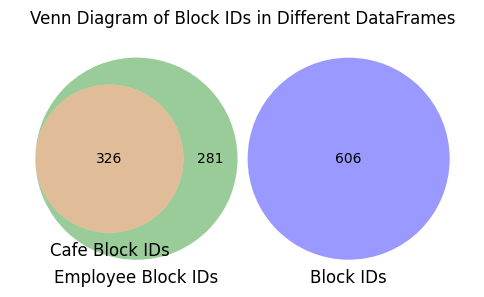

In [22]:
import numpy as np
from matplotlib_venn import venn3
import matplotlib.pyplot as plt

# Create sets of unique block IDs
cafe_block_ids = set(cafe_df['block_id'].unique())
emp_block_ids = set(emp_block_df['block_id'].unique())
block_ids = set(block_df['block_id'].unique())

# Create the Venn diagram
plt.figure(figsize=(6,6))
venn = venn3([cafe_block_ids, emp_block_ids, block_ids],
             ('Cafe Block IDs', 'Employee Block IDs', 'Block IDs'))

plt.title("Venn Diagram of Block IDs in Different DataFrames")
plt.show()

In [23]:
print("Cafe Block IDs:", len(cafe_block_ids))
print("Employee Block IDs:", len(emp_block_ids))
print("Block IDs:", len(block_ids))

Cafe Block IDs: 326
Employee Block IDs: 607
Block IDs: 606


In [24]:
# Calculate the intersection of all three sets to find common Block IDs
common_block_ids = cafe_block_ids & emp_block_ids & block_ids

# Print the number of common Block IDs
print(f"Number of Block IDs common to all three datasets: {len(common_block_ids)}")

Number of Block IDs common to all three datasets: 0


### Interpretation of Block ID Overlaps in Different DataFrames

Venn diagram illustrates that there are some kind of overlapping in Block IDs which is expected as these 3 data sets may need to merge to create more sophisticated data set.

### Merge on Block IDs

Given the overlap and availability of data, the analysis will proceed using only the 326 Block IDs that are common to both the Cafe and Employee datasets. This decision is based on the fact that these 326 Block IDs represent the locations where we have comprehensive data, including both cafe presence and employee-related information.

Focusing on these common Block IDs ensures that this analysis is based on complete datasets, allowing for more accurate and reliable insights.

In [28]:
# Merging cafe_df and emp_block_df
merged_df = pd.merge(cafe_df, emp_block_df, left_on= ['block_id', 'census_year'], right_on=['block_id', 'census_year'], how='inner')

# Merging block_df with the already merged DataFrame on 'block_id'
merged_df = pd.merge(merged_df, block_df, on='block_id', how='inner')

# Display the first few rows of the final merged DataFrame
merged_df.head() 

# This df has only the block ids available in cafe_df. 
# Many of employee details are missing which was available in emp_block_df as those block_ids were not available in cafe_df

ValueError: You are trying to merge on int64 and object columns for key 'block_id'. If you wish to proceed you should use pd.concat

In [ ]:
merged_df.columns

Index(['census_year', 'block_id', 'property_id', 'base_property_id',
       'building_address', 'clue_small_area_x', 'trading_name',
       'business_address', 'industry_anzsic4_code',
       'industry_anzsic4_description', 'seating_type', 'number_of_seats',
       'longitude', 'latitude', 'location', 'clue_small_area_y',
       'accommodation', 'admin_and_support_services', 'agriculture_and_mining',
       'arts_and_recreation_services', 'business_services', 'construction',
       'education_and_training', 'electricity_gas_water_and_waste_services',
       'finance_and_insurance', 'food_and_beverage_services',
       'health_care_and_social_assistance',
       'information_media_and_telecommunications', 'manufacturing',
       'other_services', 'public_administration_and_safety',
       'real_estate_services', 'rental_and_hiring_services', 'retail_trade',
       'transport_postal_and_storage', 'wholesale_trade',
       'total_jobs_in_block', 'total_jobs_in_block_imputed', 'geo_point_2

# Descriptive Analysis

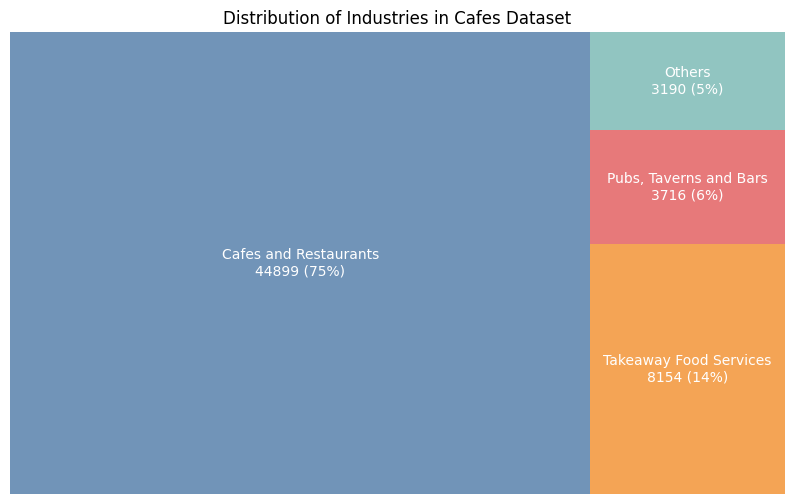

In [ ]:
# Define the same professional color palette
classic_professional_colors = ['#4E79A7', '#F28E2B', '#E15759', '#76B7B2', '#59A14F']

# Grouping smaller categories into 'Others'
threshold = 0.02  # Define a threshold below which categories will be grouped into 'Others'
industry_counts = cafes_df_cleaned['industry_anzsic4_description'].value_counts()
industry_counts['Others'] = industry_counts[industry_counts / industry_counts.sum() < threshold].sum()
industry_counts = industry_counts[industry_counts / industry_counts.sum() >= threshold]

# Calculate percentages
percentages = industry_counts / industry_counts.sum() * 100

# Prepare the labels with values and percentages
labels = [f'{label}\n{value} ({percentage:.0f}%)' for label, value, percentage in zip(industry_counts.index, industry_counts.values, percentages)]

# Plotting the treemap with white text for labels
plt.figure(figsize=(10, 6))
squarify.plot(
    sizes=industry_counts, 
    label=labels, 
    color=classic_professional_colors, 
    alpha=0.8,
    text_kwargs={'color': 'white', 'fontsize': 10}  # Set the text color to white and adjust font size
)
plt.title('Distribution of Industries in Cafes Dataset')
plt.axis('off')  # Turn off the axis
plt.show()

#### Distribution of Industries in Cafes Dataset

The dataset represents the distribution of various industries related to cafes. Below is a breakdown:

- **Cafes and Restaurants**: 44,899 (75%)
- **Takeaway Food Services**: 8,154 (14%)
- **Pubs, Taverns, and Bars**: 3,716 (6%)
- **Others**: 3,190 (5%)

The treemap visualizes the dominance of Cafes and Restaurants in the dataset, followed by Takeaway Food Services, Pubs, Taverns, and Bars, and other related industries.

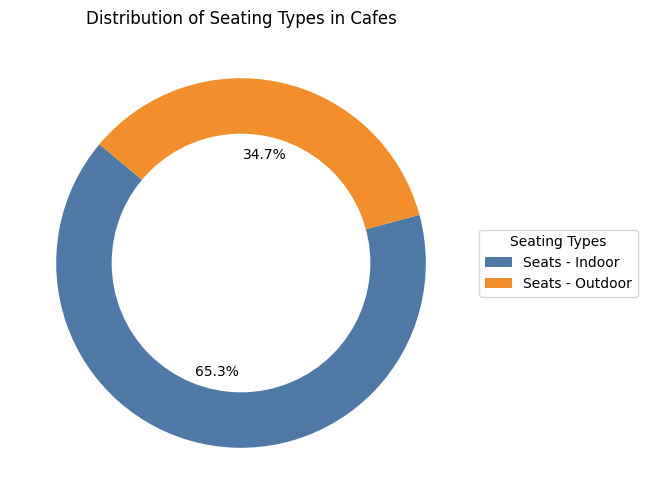

In [ ]:
import matplotlib.pyplot as plt

# Example data: replace with your actual data column
seating_counts = cafes_df_cleaned['seating_type'].value_counts()

# Define the same professional color palette
classic_professional_colors = ['#4E79A7', '#F28E2B', '#E15759', '#76B7B2', '#59A14F']

# Plotting the donut chart
plt.figure(figsize=(8, 6))
wedges, texts, autotexts = plt.pie(
    seating_counts, 
    colors=classic_professional_colors, 
    autopct='%1.1f%%',  # Display percentages
    startangle=140, 
    wedgeprops={'width': 0.4}  # Make it a donut by adjusting the width
)

# Adding a circle at the center to make it a donut chart
centre_circle = plt.Circle((0, 0), 0.70, fc='white')
fig = plt.gcf()
fig.gca().add_artist(centre_circle)

# Adding title
plt.title('Distribution of Seating Types in Cafes')

# Adding the legend on the side
plt.legend(wedges, seating_counts.index, title="Seating Types", loc="center left", bbox_to_anchor=(1, 0, 0.5, 1))

# Show the plot
plt.show()

#### Distribution of Seating Types in Cafes

The donut chart above illustrates the distribution of different seating types in cafes. The chart shows the proportion of places that have indoor and outdoor seating options.

#### Chart Description:
- **Seating Types**:
  - **Indoor Seats**: Represented by the blue section, making up 65.3% of the seating types.
  - **Outdoor Seats**: Represented by the orange section, accounting for 34.7% of the seating types.

### Top 10 Blocks by Seating Capacity

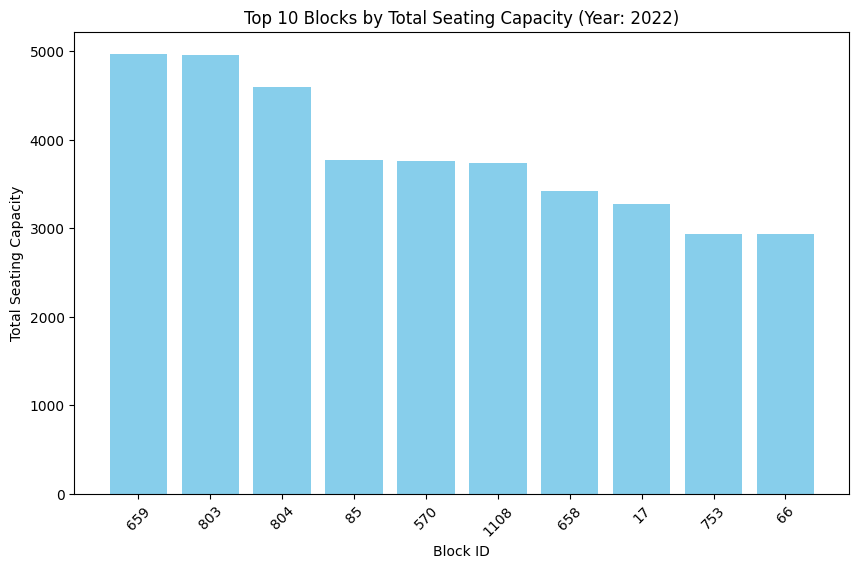

In [29]:
# Calculate the total seating capacity per Block and Census Year
seating_capacity_per_block = cafes_df_cleaned.groupby(['census_year', 'block_id'])['number_of_seats'].sum().reset_index()

# Rename the columns for clarity
seating_capacity_per_block.columns = ['Census Year', 'Block ID', 'Total Seating Capacity']

# Change data type of block id col
seating_capacity_per_block['Block ID'] = seating_capacity_per_block['Block ID'].astype('str')

# Find the latest year in the data
latest_year = seating_capacity_per_block['Census Year'].max()

# Filter the DataFrame to include only data from the latest year
latest_year_data = seating_capacity_per_block[seating_capacity_per_block['Census Year'] == latest_year]

# Sort the data by 'Total Seating Capacity' in descending order and select the top 10 blocks
top_10_blocks_latest_year = latest_year_data.sort_values(by='Total Seating Capacity', ascending=False).head(10)

# Plot the data for the latest year
plt.figure(figsize=(10, 6))
plt.bar(top_10_blocks_latest_year['Block ID'], top_10_blocks_latest_year['Total Seating Capacity'], color='skyblue')
plt.xlabel('Block ID')
plt.ylabel('Total Seating Capacity')
plt.title(f'Top 10 Blocks by Total Seating Capacity (Year: {latest_year})')
plt.xticks(rotation=45)
plt.show()

### Top 10 Blocks by Total Workers

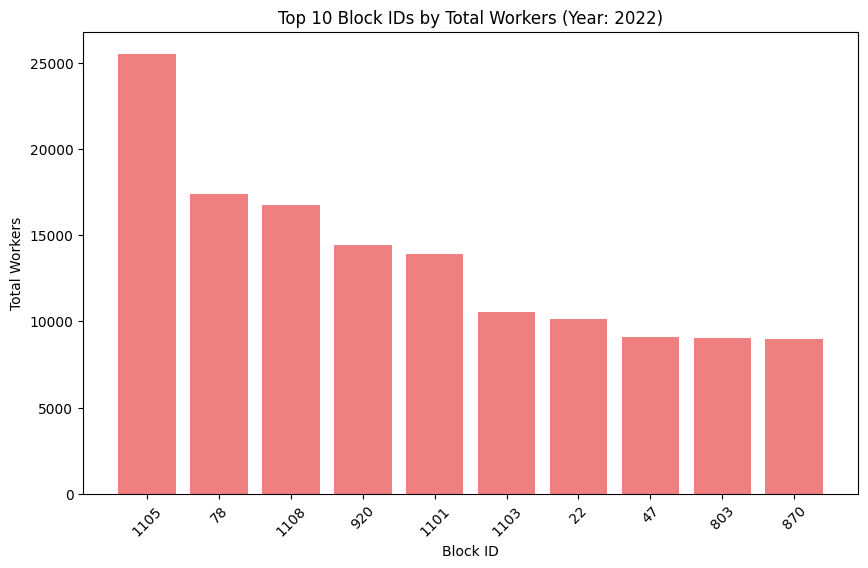

In [27]:
# Calculate the total number of workers per Block ID
workers_per_block = emp_block_df.groupby(['census_year', 'block_id'])['total_jobs_in_block_imputed'].sum().reset_index()

# Exclude Block ID 0 before renaming the columns
workers_per_block = workers_per_block[workers_per_block['block_id'] != 0]

# Rename the columns for clarity
workers_per_block.columns = ['Census Year', 'Block ID', 'Total Workers']

# Change data type of block id col
workers_per_block['Block ID'] = workers_per_block['Block ID'].astype('str')

# Find the latest year in the data
latest_year = workers_per_block['Census Year'].max()

# Filter the DataFrame to include only data from the latest year
latest_year_data = workers_per_block[workers_per_block['Census Year'] == latest_year]

# Select the top 10 Block IDs with the highest total workers for the latest year
top_10_blocks_workers = latest_year_data.nlargest(10, 'Total Workers')

# Ensure Block ID is treated as categorical data
top_10_blocks_workers['Block ID'] = top_10_blocks_workers['Block ID'].astype(str)

# Bar Chart: Top 10 Block IDs with the highest total workers for the latest year
plt.figure(figsize=(10, 6))
plt.bar(top_10_blocks_workers['Block ID'], top_10_blocks_workers['Total Workers'], color='lightcoral')
plt.xlabel('Block ID')
plt.ylabel('Total Workers')
plt.title(f'Top 10 Block IDs by Total Workers (Year: {latest_year})')
plt.xticks(rotation=45)
plt.show()

# Advanced Analysis

### Merging Seating Capacity and Employment Data for Block ID

In this step, we merge the seating capacity and employment data for each Block ID. This combined dataset allows us to analyze the relationship between the total seating capacity in cafes/restaurants and the total number of workers within each block.

We calculate the worker-to-seat ratio, which provides valuable insights into the balance between available seating and the workforce in a given area. A high worker-to-seat ratio indicates that there are significantly more workers than available seats, potentially highlighting areas where additional cafes/restaurants could be beneficial to meet demand.

By visualizing this ratio across all Block IDs, we can identify specific blocks where the demand for seating might exceed supply, guiding decisions for potential expansion of food and beverage establishments. This analysis can help prioritize investments in areas where additional seating capacity is needed to support the local workforce.


In [30]:
# Merge seating capacity and workers per Block ID
block_comparison_df = pd.merge(seating_capacity_per_block, workers_per_block, on=['Census Year', 'Block ID'], how='inner')

# Calculate the worker-to-seat ratio for each Block ID
block_comparison_df['Worker to Seat Ratio'] = block_comparison_df['Total Workers'] / block_comparison_df['Total Seating Capacity']

# Display the first few rows of the result
print(block_comparison_df.head())
block_comparison_df.shape


   Census Year Block ID  Total Seating Capacity  Total Workers  \
0         2002        2                     151          169.0   
1         2002        4                     159         1174.0   
2         2002        5                      20           12.0   
3         2002        6                      80          360.0   
4         2002       11                     316          733.0   

   Worker to Seat Ratio  
0              1.119205  
1              7.383648  
2              0.600000  
3              4.500000  
4              2.319620  


(5674, 5)

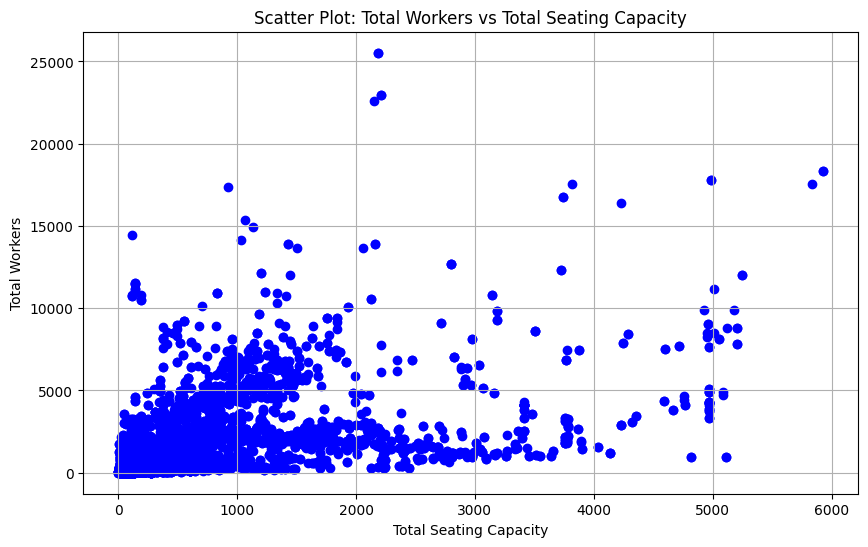

In [31]:
import matplotlib.pyplot as plt

# Scatter Plot: Total Workers vs Total Seating Capacity
plt.figure(figsize=(10, 6))
plt.scatter(block_comparison_df['Total Seating Capacity'], block_comparison_df['Total Workers'], color='blue')
plt.xlabel('Total Seating Capacity')
plt.ylabel('Total Workers')
plt.title('Scatter Plot: Total Workers vs Total Seating Capacity')
plt.grid(True)
plt.show()


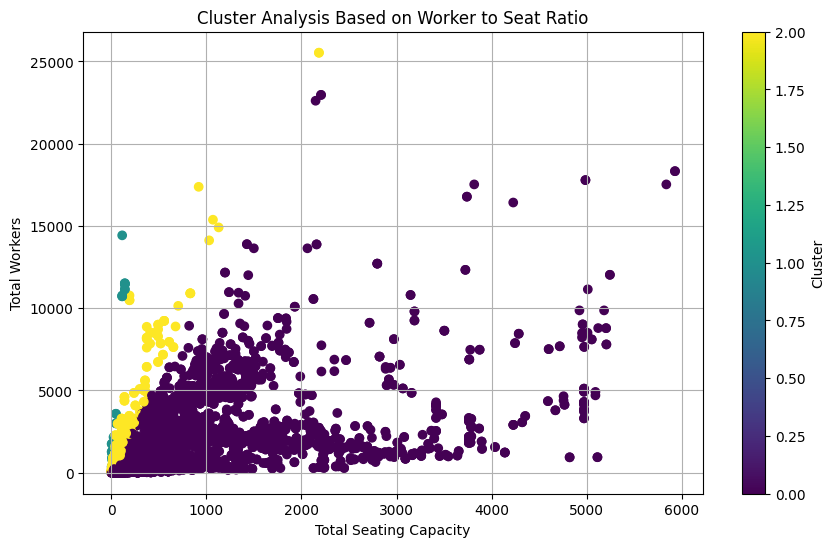

In [32]:
from sklearn.cluster import KMeans
import numpy as np
import matplotlib.pyplot as plt

# Use the Worker to Seat Ratio for clustering
X = block_comparison_df[['Worker to Seat Ratio']]

# Apply K-Means clustering
kmeans = KMeans(n_clusters=3, random_state=42)  # You can adjust the number of clusters as needed
block_comparison_df['Cluster'] = kmeans.fit_predict(X)

# Scatter plot with clusters using Total Seating Capacity and Total Workers for visualization
plt.figure(figsize=(10, 6))
plt.scatter(block_comparison_df['Total Seating Capacity'], block_comparison_df['Total Workers'], 
            c=block_comparison_df['Cluster'], cmap='viridis', marker='o')
plt.xlabel('Total Seating Capacity')
plt.ylabel('Total Workers')
plt.title('Cluster Analysis Based on Worker to Seat Ratio')
plt.colorbar(label='Cluster')
plt.grid(True)
plt.show()


Cluster
Balanced area             2.489265
Potential growth area    19.407073
Restaurant Hotspot       94.261883
Name: Worker to Seat Ratio, dtype: float64


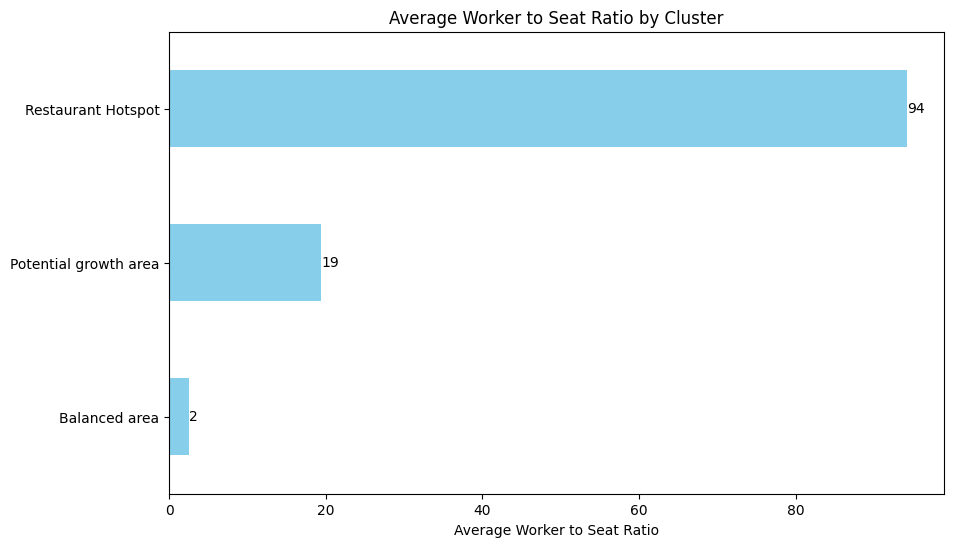

In [33]:
# Group by the 'Cluster' and calculate the mean of the 'Worker to Seat Ratio'
cluster_means = block_comparison_df.groupby('Cluster')['Worker to Seat Ratio'].mean()

# Rename the clusters for better readability
cluster_means.index = cluster_means.index.map({
    0: 'Balanced area',        # Assuming cluster 0 corresponds to 'Balanced area'
    1: 'Restaurant Hotspot',   # Assuming cluster 1 corresponds to 'Restaurant Hotspot'
    2: 'Potential growth area' # Assuming cluster 2 corresponds to 'Potential growth area'
})

# Sort the means in descending order
cluster_means = cluster_means.sort_values(ascending=True)

# Print the calculated means for each cluster
print(cluster_means)

# Plotting the bar chart
plt.figure(figsize=(10, 6))
cluster_means.plot(kind='barh', color='skyblue')

# Adding labels and title
plt.xlabel('Average Worker to Seat Ratio')
plt.ylabel('')
plt.title('Average Worker to Seat Ratio by Cluster')

# Adding data labels
for index, value in enumerate(cluster_means):
    plt.text(value, index, f'{value:.0f}', va='center')

# Show the plot
plt.show()

In [34]:
# Merge the block comparison data with the geo shape data
block_comparison_with_geo_df = pd.merge(block_comparison_df, block_df, left_on='Block ID', right_on='block_id', how='inner')

# Drop the duplicate block_id column and the clue_area column
block_comparison_with_geo_df = block_comparison_with_geo_df.drop(columns=['block_id', 'clue_area'])

# Display the first few rows of the result
print(block_comparison_with_geo_df.head())

   Census Year Block ID  Total Seating Capacity  Total Workers  \
0         2002        2                     151          169.0   
1         2002        4                     159         1174.0   
2         2002        5                      20           12.0   
3         2002        6                      80          360.0   
4         2002       11                     316          733.0   

   Worker to Seat Ratio  Cluster                             geo_point_2d  \
0              1.119205        0  -37.820535441773465, 144.95952183480324   
1              7.383648        0  -37.819024653535394, 144.96481167015463   
2              0.600000        0    -37.81784670466526, 144.9661311515247   
3              4.500000        0   -37.81772201812595, 144.97026050566197   
4              2.319620        0  -37.820239388269975, 144.95608593421295   

                                           geo_shape  
0  {"coordinates": [[[144.961388745, -37.82056488...  
1  {"coordinates": [[[144.9647

### Updated map

In [35]:
import ast

# Function to safely parse the geo_point_2d column
def parse_geo_point(geo_point):
    try:
        # Convert the string representation of the list to an actual list
        point = ast.literal_eval(geo_point)
        return point[1], point[0]  # return latitude, longitude
    except:
        return None, None  # in case of an error

# Apply the function to the DataFrame to create new columns for latitude and longitude
block_comparison_with_geo_df['latitude'], block_comparison_with_geo_df['longitude'] = zip(*block_comparison_with_geo_df['geo_point_2d'].apply(parse_geo_point))

# Filter out rows where latitude or longitude could not be parsed
block_comparison_with_geo_df = block_comparison_with_geo_df.dropna(subset=['latitude', 'longitude'])

# Display the first few rows to verify
print(block_comparison_with_geo_df.head())


   Census Year Block ID  Total Seating Capacity  Total Workers  \
0         2002        2                     151          169.0   
1         2002        4                     159         1174.0   
2         2002        5                      20           12.0   
3         2002        6                      80          360.0   
4         2002       11                     316          733.0   

   Worker to Seat Ratio  Cluster                             geo_point_2d  \
0              1.119205        0  -37.820535441773465, 144.95952183480324   
1              7.383648        0  -37.819024653535394, 144.96481167015463   
2              0.600000        0    -37.81784670466526, 144.9661311515247   
3              4.500000        0   -37.81772201812595, 144.97026050566197   
4              2.319620        0  -37.820239388269975, 144.95608593421295   

                                           geo_shape    latitude  longitude  
0  {"coordinates": [[[144.961388745, -37.82056488...  144.9595

In [36]:
import folium
from folium.plugins import MarkerCluster
import json

# Initialize a map centered around Melbourne
m = folium.Map(location=[-37.8136, 144.9631], zoom_start=12)

# Create a marker cluster
marker_cluster = MarkerCluster().add_to(m)

# Function to add geojson shape to the map with professional tooltips and annotations
def add_shape(row, map_obj):
    geo_shape = row['geo_shape']
    
    # Convert geo_shape from string to dictionary if needed
    if isinstance(geo_shape, str):
        geo_shape = json.loads(geo_shape)
    
    # Assign a color based on cluster
    cluster = row['Cluster']
    if cluster == 0:
        color = 'green'
    elif cluster == 1:
        color = 'red'
    else:  # cluster == 2
        color = 'orange'
    
    # Create a popup with detailed information
    popup_content = f"""
    <strong>Block ID:</strong> {row['Block ID']}<br>
    <strong>Total Workers:</strong> {row['Total Workers']:.0f}<br>
    <strong>Total Seating Capacity:</strong> {row['Total Seating Capacity']:.0f}<br>
    <strong>Worker to Seat Ratio:</strong> {row['Worker to Seat Ratio']:.2f}
    """
    popup = folium.Popup(popup_content, max_width=300)

    # Professional tooltip content
    tooltip_content = f"""
    <div style="font-family: Arial, sans-serif; font-size: 12px; padding: 5px;">
        <strong>{row['Block ID']}</strong><br>
        <span style="color: gray;">Workers: {row['Total Workers']:.0f}</span><br>
        <span style="color: gray;">Seats: {row['Total Seating Capacity']:.0f}</span><br>
        <span style="color: {'#FF6347' if cluster == 1 else '#FFA500' if cluster == 2 else '#32CD32'};">
        Worker to Seat Ratio: {row['Worker to Seat Ratio']:.2f}</span>
    </div>
    """

    # Add geojson shape with popup and professional tooltip
    folium.GeoJson(
        geo_shape,
        style_function=lambda feature: {
            'fillColor': color,
            'color': color,
            'weight': 2,
            'fillOpacity': 0.05,
        },
        highlight_function=lambda feature: {
            'weight': 3,
            'color': 'yellow',
            'fillOpacity': 0.05,
        },
        tooltip=folium.Tooltip(tooltip_content, sticky=False),
    ).add_child(popup).add_to(map_obj)

# Loop through the cleaned dataframe and add markers and shapes to the map
for idx, row in block_comparison_with_geo_df.iterrows():
    # Add the marker
    folium.Marker(
        location=[row['latitude'], row['longitude']],  # Use parsed latitude and longitude
        popup=f"Block ID: {row['Block ID']}<br>"
              f"Total Workers: {row['Total Workers']}<br>"
              f"Total Seating Capacity: {row['Total Seating Capacity']}<br>"
              f"Worker to Seat Ratio: {row['Worker to Seat Ratio']:.2f}",
        icon=folium.Icon(color='blue' if row['Worker to Seat Ratio'] > 5 else 'green')
    ).add_to(marker_cluster)
    
    # Add the shape with color coding and professional tooltip
    add_shape(row, m)

# Define and add the legend
legend_html = """
<div style="
    position: fixed; 
    bottom: 50px; left: 50px; width: 200px; height: 150px; 
    background-color: white; border:2px solid grey; z-index:9999; 
    font-size:14px;
    ">
    &nbsp; <strong>Legend</strong> <br>
    &nbsp; <i class="fa fa-square" style="color:green"></i>&nbsp; Balanced area <br>
    &nbsp; <i class="fa fa-square" style="color:red"></i>&nbsp; Restaurant Hotspot <br>
    &nbsp; <i class="fa fa-square" style="color:orange"></i>&nbsp; Potential growth area <br>
</div>
"""
m.get_root().html.add_child(folium.Element(legend_html))

# Display the map
m


## Correlation Analysis

In [44]:
# Assuming your dataframe is called block_comparison_df
import pandas as pd

# Calculate the correlation between Total Seating Capacity and Total Workers
correlation_matrix = block_comparison_df[['Total Seating Capacity', 'Total Workers']].corr()

# Extract the correlation coefficient
correlation_coefficient = correlation_matrix.loc['Total Seating Capacity', 'Total Workers']

print(f'Correlation between Total Seating Capacity and Total Workers: {correlation_coefficient}')

Correlation between Total Seating Capacity and Total Workers: 0.5179552076390479


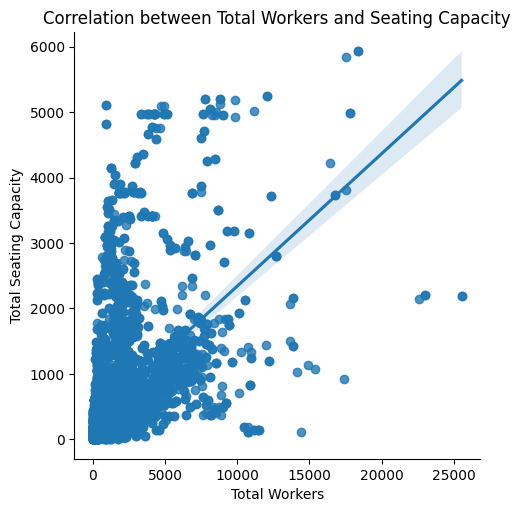

In [45]:
import matplotlib.pyplot as plt
import seaborn as sns

# Scatter plot with regression line
sns.lmplot(x='Total Workers', y='Total Seating Capacity', data=block_comparison_df)
plt.title('Correlation between Total Workers and Seating Capacity')
plt.show()

In [55]:
# Group the data by Block ID
block_groups = block_comparison_df.groupby('Block ID')

# Initialize a dictionary to store the correlation for each block
block_correlations = {}

# Loop through each group (block)
for block_id, group in block_groups:
    if len(group) > 1:  # Ensure the block has more than one year of data
        correlation_matrix = group[['Total Seating Capacity', 'Total Workers']].corr()
        correlation_value = correlation_matrix.loc['Total Seating Capacity', 'Total Workers']
        block_correlations[block_id] = correlation_value

# Convert the dictionary to a DataFrame for easy viewing
block_correlation_df = pd.DataFrame(list(block_correlations.items()), columns=['Block ID', 'Correlation'])

# Filter blocks with strong positive correlation (for example, > 0.7)
strong_blocks = block_correlation_df[block_correlation_df['Correlation'] < 0]

# Display the blocks with strong correlation
print(strong_blocks)

    Block ID  Correlation
2       1005    -0.307864
7        104    -0.454040
18       111    -0.222633
21       113    -0.530585
35       203    -0.175370
..       ...          ...
312      920    -0.776773
316       93    -0.277916
319       94    -0.618523
321       96    -0.423980
322       97    -0.088660

[107 rows x 2 columns]


/var/folders/t6/9l2hs7mn2xdctfjmwqkr480h0000gn/T/ipykernel_67939/1928589080.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Block ID', y='Correlation', data=sorted_blocks, palette='viridis')


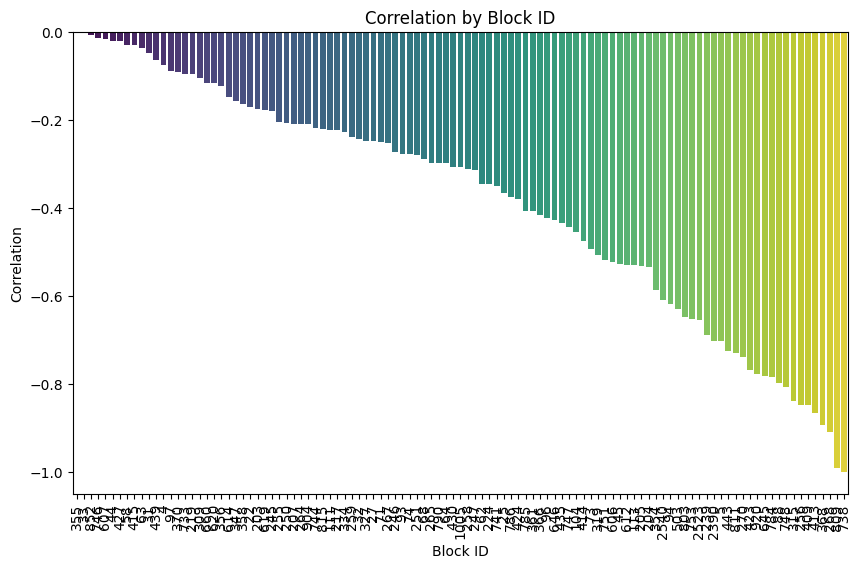

In [56]:
import matplotlib.pyplot as plt
import seaborn as sns

# Sort by correlation
sorted_blocks = strong_blocks.sort_values(by='Correlation', ascending=False)

# Bar chart
plt.figure(figsize=(10, 6))
sns.barplot(x='Block ID', y='Correlation', data=sorted_blocks, palette='viridis')
plt.xticks(rotation=90)
plt.title('Correlation by Block ID')
plt.show()

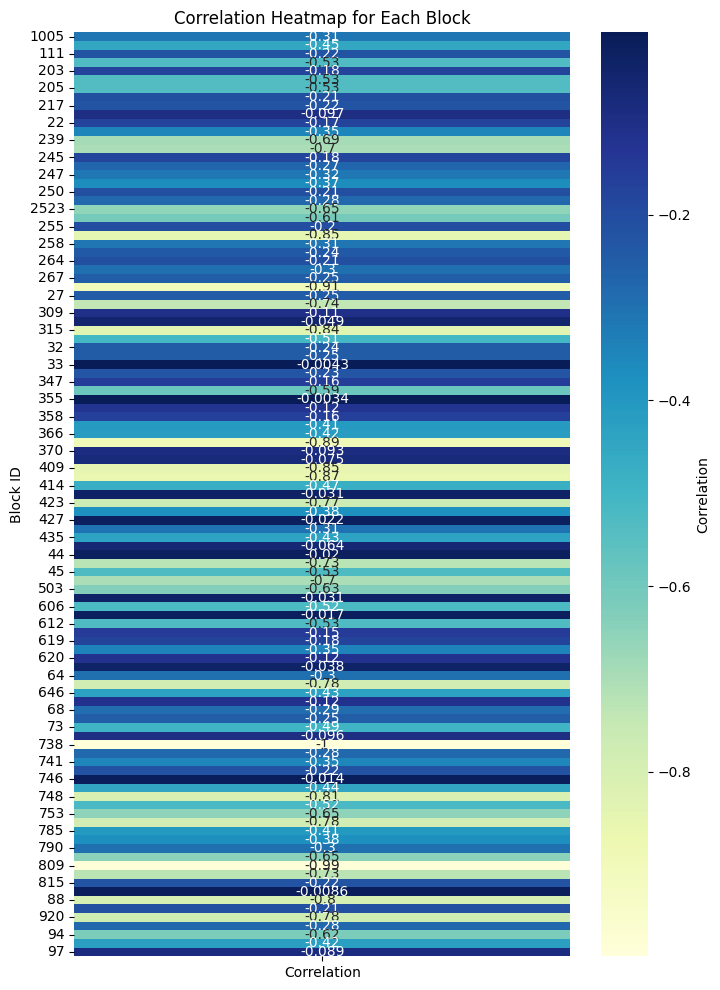

In [57]:
# Pivot table to create a matrix-like structure for a heatmap
pivot_table = strong_blocks.pivot_table(index='Block ID', values='Correlation')

# Heatmap
plt.figure(figsize=(8, 12))
sns.heatmap(pivot_table, annot=True, cmap='YlGnBu', cbar_kws={'label': 'Correlation'})
plt.title('Correlation Heatmap for Each Block')
plt.show()

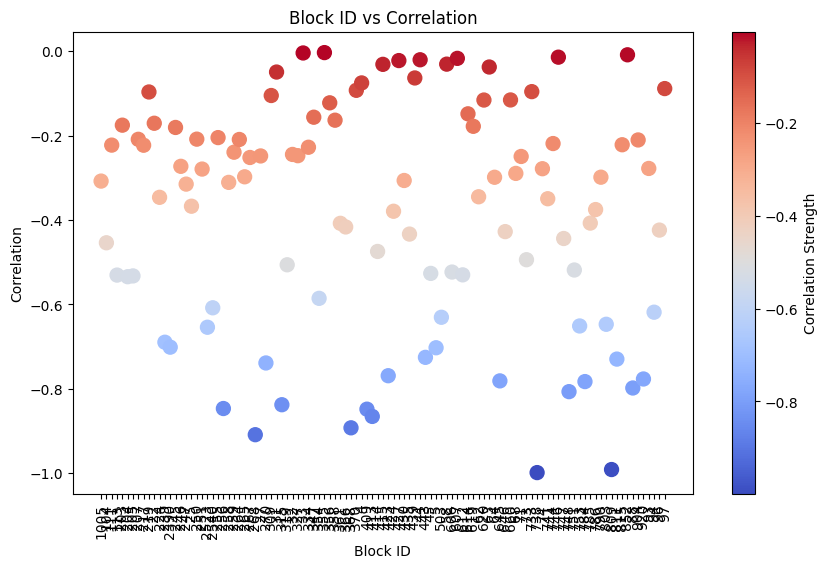

In [58]:
plt.figure(figsize=(10, 6))
plt.scatter(strong_blocks['Block ID'], strong_blocks['Correlation'], 
            c=strong_blocks['Correlation'], cmap='coolwarm', s=100)
plt.colorbar(label='Correlation Strength')
plt.title('Block ID vs Correlation')
plt.xlabel('Block ID')
plt.ylabel('Correlation')
plt.xticks(rotation=90)
plt.show()

## Trend Analysis

In [39]:
emp_block_df.columns

Index(['census_year', 'block_id', 'clue_small_area', 'accommodation',
       'admin_and_support_services', 'agriculture_and_mining',
       'arts_and_recreation_services', 'business_services', 'construction',
       'education_and_training', 'electricity_gas_water_and_waste_services',
       'finance_and_insurance', 'food_and_beverage_services',
       'health_care_and_social_assistance',
       'information_media_and_telecommunications', 'manufacturing',
       'other_services', 'public_administration_and_safety',
       'real_estate_services', 'rental_and_hiring_services', 'retail_trade',
       'transport_postal_and_storage', 'wholesale_trade',
       'total_jobs_in_block', 'total_jobs_in_block_imputed'],
      dtype='object')

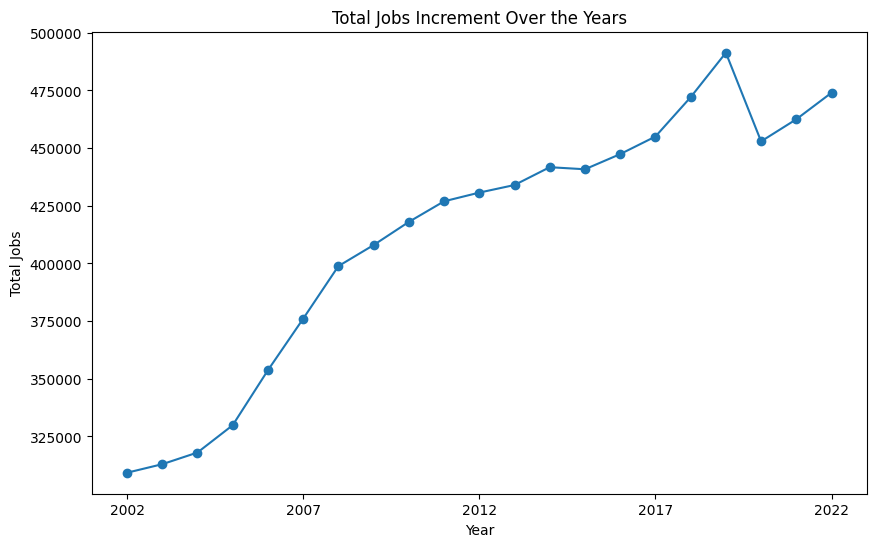

In [40]:
# Exclude block_id = 0, as it includes aggregated values
emp_block_df_filtered = emp_block_df[emp_block_df['block_id'] != 0] 

# Grouping the data by 'census_year' and summing up the 'total_jobs_in_block'
jobs_by_year = emp_block_df_filtered.groupby('census_year')['total_jobs_in_block'].sum()

# Ensure the job totals are integers
jobs_by_year = jobs_by_year.astype(int)

# Plotting the data
plt.figure(figsize=(10, 6))
jobs_by_year.plot(kind='line', marker='o')
plt.title('Total Jobs Increment Over the Years')
plt.xlabel('Year')
plt.ylabel('Total Jobs')

# Setting x-ticks to show only some of the years (e.g., every 5 years)
plt.xticks(ticks=jobs_by_year.index[::5], labels=[str(year) for year in jobs_by_year.index[::5]])

plt.grid(False)  # Disable the grid

plt.show()

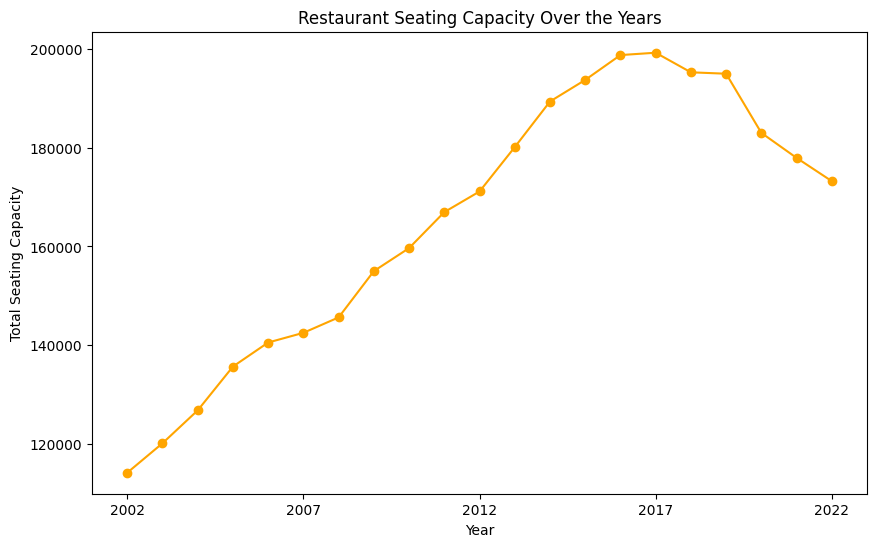

In [38]:
# Grouping the data by 'census_year' and summing up the 'number_of_seats'
seating_by_year = cafe_df.groupby('census_year')['number_of_seats'].sum()

# Plotting the data
plt.figure(figsize=(10, 6))
seating_by_year.plot(kind='line', marker='o', color='orange')
plt.title('Restaurant Seating Capacity Over the Years')
plt.xlabel('Year')
plt.ylabel('Total Seating Capacity')

# Setting x-ticks to show only some of the years (e.g., every 5 years)
plt.xticks(ticks=seating_by_year.index[::5], labels=[str(year) for year in seating_by_year.index[::5]])

plt.grid(False)  # Disable the grid

plt.show()
